<a href="https://colab.research.google.com/github/marcy3ait/AerodinamicaComputacional/blob/master/Simu4_DiscretizacaoTimeSpace.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analise dos metodos de discretização do tempo e espaço para equações modelos.

In [ ]:
# -*- coding: utf-8 -*-

import numpy as npy
import matplotlib.pyplot as plt

import matplotlib.animation as animation
from matplotlib import rc
from IPython.display import HTML
rc('animation', html='jshtml')


# Discretização espacial para derivada primeira
def derivada_primeira(f,dx,metodo):
    n = f.shape[0]
    dfdx = f*0.0
   
    # método centrado de O(dx^2)
    if (metodo == 1):
        for i in range(1,n-1):
            dfdx[i] = (f[i+1] - f[i-1])/2.0
    
    # método forward O(dx)
    elif(metodo == 2):
        for i in range(1,n-1):
            dfdx[i] = (f[i+1] - f[i])
    
    # método backward O(dx)
    elif(metodo == 3):
        for i in range(1,n-1):
            dfdx[i] = (f[i] - f[i-1])

    else:
        print('Erro! método não implementado')

    return  dfdx/dx



# Discretização espacial para derivada segunda
def derivada_segunda(f,dx,):
    n = f.shape[0]
    df2dx2 = f*0.0
   
    # método centrado de O(dx^2)
    for i in range(1,n-1):
        df2dx2[i] = (f[i+1] -2.0*f[i] + f[i-1])/dx**2


    return  df2dx2




def CalculoRHS(u,x,a,metodo,eq):

    if (eq ==1):
        # equação modelo de "convecção" (onda ou advecção)
        # du/dt = -a*du/dx
        # dudt =  RHS (right hand side)
        RHS = -a*derivada_primeira(u,dx,metodo)

    else:
        # equação modelo de difusão
        # du/dt = a*d2u/dx2
        # dudt =  RHS (right hand side)
        RHS = a*derivada_segunda(u,dx)

    return RHS




# Realiza a marcha no tempo usando Euler explícito
def Euler(u,x,a,metodo,eq):
    #print(u)
    # equação modelo de "convecção" (onda ou advecção)
    # du/dt = -a*du/dx
    # dudt =  RHS (right hand side)
    RHS = CalculoRHS(u,x,a,metodo,eq)
    
    # Euler explícito para marcha no tempo
    u = u + dt*RHS
    
    u = CondicaoContorno(u)

    return u



# Realiza a marcha no tempo usando Runge-Kutta de 2 estágios segunda ordem
def RK2(u,x,a,metodo,eq):

    # 1o estágio
    RHS = CalculoRHS(u,x,a,metodo,eq)
    us = u + dt*RHS

    # condição de contorno para o estágio 1, atualiza pontos [0] e [nx-1]
    us = CondicaoContorno(us)
    
    # 2o estágio
    RHS2 = CalculoRHS(us,x,a,metodo,eq)
    u = u + dt*0.5*(RHS+RHS2)

    # condição de contorno para o estágio 2, atualiza pontos [0] e [nx-1]
    u = CondicaoContorno(u)
    
    return u

# Realiza a marcha no tempo usando Runge-Kutta de 4 estágios segunda ordem
def RK4(u,x,a,metodo,eq):

    # 1o estágio
    RHS1 = CalculoRHS(u,x,a,metodo,eq) # derivada no espaço u'n
    u1 = u + 0.5*dt*RHS1 #ûn+1/2

    # condição de contorno para o estágio 1, atualiza pontos [0] e [nx-1]
    u1 = CondicaoContorno(u1)

    # 2o estágio
    RHS2 = CalculoRHS(u1,x,a,metodo,eq)
    u2 = u + dt*0.5*(RHS2)

    u2 = CondicaoContorno(u2)

    # 3o estágio
    RHS3 = CalculoRHS(u2,x,a,metodo,eq)
    u3 = u + dt*(RHS3)
    
    u3 = CondicaoContorno(u3)

    RHS4 = CalculoRHS(u3,x,a,metodo,eq)

    u = u +(1/6)*dt*(RHS1 + 2*(RHS2 + RHS3)+ RHS4)
    # condição de contorno para o estágio 2, atualiza pontos [0] e [nx-1]
    u = CondicaoContorno(u)

    return u


def CondicaoContorno(u):
    n = len(u)

    u[0] = 0        # u(0) = 0
    u[n-1] = u[n-2] # du/dx = 0
    
    # periódica
    # u[0]= u[n-2]
    # u[1]= u[n-1]
    return u



def CondicaoInicial(x):
    
    u = x*0.0
    u = 1.0/(1.0+25.0*x**2)

    return u





# Com a>0
O método Runge-kutta de 4ª ordem parece apresentar divergencia para valores maiores de CFL que raiz de 2. Os outros métodos testados juntos mostram-se ser instaveis para esse valor de CFL.

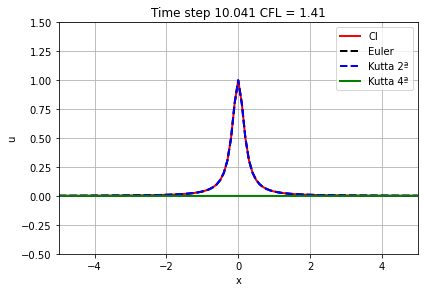

In [ ]:
#@title Backward
# parâmtros de setup da simulação

Lx  = 10     # Tamanho do domínio em x
nx  = 101    # Número de pontos em x
CFL = npy.sqrt(2)#1#0.5   # Número de CFL
a =   1.0    # Velocidade da onda
T = 10.0     # Período de integração

# método numérico para derivada primeira:
# 1 = centrado O(dx^2)
# 2 = forward O(dx)
# 3 = backward O(dx)
metodo = 3

# Equação modelo: 
# eq = 1  => eq. modelo da onda ("convecção")
# eq =! 1 => eq. modelo da difusão
eq = 1  


# definindo dx
dx = Lx/float(nx-1)


# calculando o número de CFL
if (eq == 1):
    dt = CFL*dx/a
else:
    dt = CFL*dx**2/a

# número de passos no tempo até T
step = int(T/dt)

# definindo a malha
x = npy.linspace(-Lx/2,Lx/2,nx) #K variando de [0,pi]


# aplica a condição inicial
u = CondicaoInicial(x)
uu = CondicaoInicial(x)
uuu = CondicaoInicial(x)
u0 = u*1.0



fig,ax = plt.subplots()
ax.set_xlabel('x')
ax.set_ylabel('u')
plt.grid()
line = plt.plot(x, u0,
                   color='r', linestyle='-', linewidth=2, Label = 'CI')[0]
line2 = plt.plot(x, u0,
                   color='k', linestyle='--', linewidth=2,Label = 'Euler')[0]
line3 = plt.plot(x, u0,
                   color='b', linestyle='--', linewidth=2,Label = 'Kutta 2ª')[0]
line4 = plt.plot(x, u0,
                   color='g', linestyle='-', linewidth=2,Label = 'Kutta 4ª')[0]
plt.legend()

plt.xlim(x.min(),x.max())
plt.ylim(-0.5,1.5)
fig.tight_layout()
cont = 1
def animacao(frame):
    global cont
    global u,uu,uuu
    ax.set_title('Time step %2.3f CFL = %1.2f'%(cont*dt,CFL))
    #u = Euler(u,x,a,metodo,eq)
    #uu = RK2(uu,x,a,metodo,eq)
    uuu = RK4(uuu,x,a,metodo,eq)
    #print(uuu-uu)
    #line2.set_ydata(u)
    #line3.set_ydata(uu)
    line4.set_ydata(uuu)
    cont+=1

anim = animation.FuncAnimation(fig, animacao,
                               frames=step-1,
                               interval=100)
anim



Para o método centrado há a apresença de oscilações na resposta,essas se mantém constantes e não inferem na estabilidade da resposta. E para discretização no espaço Forward a solução se mostra instável.

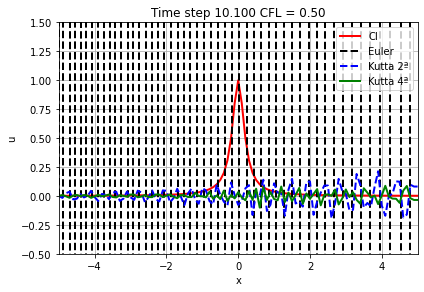

In [ ]:
#@title Centrada
# parâmtros de setup da simulação

Lx  = 10     # Tamanho do domínio em x
nx  = 101    # Número de pontos em x
CFL = 0.5#npy.sqrt(2)#1#0.5   # Número de CFL
a =   1.0    # Velocidade da onda
T = 10.0     # Período de integração

# método numérico para derivada primeira:
# 1 = centrado O(dx^2)
# 2 = forward O(dx)
# 3 = backward O(dx)
metodo = 1

# Equação modelo: 
# eq = 1  => eq. modelo da onda ("convecção")
# eq =! 1 => eq. modelo da difusão
eq = 1  


# definindo dx
dx = Lx/float(nx-1)


# calculando o número de CFL
if (eq == 1):
    dt = CFL*dx/a
else:
    dt = CFL*dx**2/a

# número de passos no tempo até T
step = int(T/dt)

# definindo a malha
x = npy.linspace(-Lx/2,Lx/2,nx) #K variando de [0,pi]


# aplica a condição inicial
u = CondicaoInicial(x)
uu = CondicaoInicial(x)
uuu = CondicaoInicial(x)
u0 = u*1.0



fig,ax = plt.subplots()
ax.set_xlabel('x')
ax.set_ylabel('u')
plt.grid()
line = plt.plot(x, u0,
                   color='r', linestyle='-', linewidth=2, Label = 'CI')[0]
line2 = plt.plot(x, u0,
                   color='k', linestyle='--', linewidth=2,Label = 'Euler')[0]
line3 = plt.plot(x, u0,
                   color='b', linestyle='--', linewidth=2,Label = 'Kutta 2ª')[0]
line4 = plt.plot(x, u0,
                   color='g', linestyle='-', linewidth=2,Label = 'Kutta 4ª')[0]
plt.legend()

plt.xlim(x.min(),x.max())
plt.ylim(-0.5,1.5)
fig.tight_layout()
cont = 1
def animacao(frame):
    global cont
    global u,uu,uuu
    ax.set_title('Time step %2.3f CFL = %1.2f'%(cont*dt,CFL))
    u = Euler(u,x,a,metodo,eq)
    uu = RK2(uu,x,a,metodo,eq)
    uuu = RK4(uuu,x,a,metodo,eq)
    #print(uuu-uu)
    line2.set_ydata(u)
    line3.set_ydata(uu)
    line4.set_ydata(uuu)
    cont+=1

anim = animation.FuncAnimation(fig, animacao,
                               frames=step,
                               interval=100)
anim


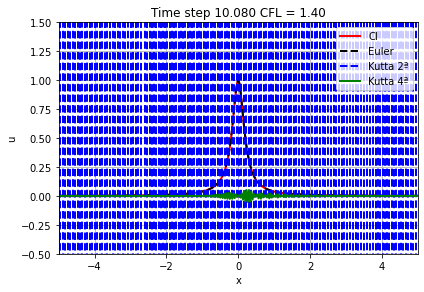

In [ ]:
#@title Centrada
# parâmtros de setup da simulação

Lx  = 10     # Tamanho do domínio em x
nx  = 301    # Número de pontos em x
CFL = 1.4#npy.sqrt(2)#1#0.5   # Número de CFL
a =   1.0    # Velocidade da onda
T = 10.0     # Período de integração

# método numérico para derivada primeira:
# 1 = centrado O(dx^2)
# 2 = forward O(dx)
# 3 = backward O(dx)
metodo = 1

# Equação modelo: 
# eq = 1  => eq. modelo da onda ("convecção")
# eq =! 1 => eq. modelo da difusão
eq = 1  


# definindo dx
dx = Lx/float(nx-1)


# calculando o número de CFL
if (eq == 1):
    dt = CFL*dx/a
else:
    dt = CFL*dx**2/a

# número de passos no tempo até T
step = int(T/dt)

# definindo a malha
x = npy.linspace(-Lx/2,Lx/2,nx) #K variando de [0,pi]


# aplica a condição inicial
u = CondicaoInicial(x)
uu = CondicaoInicial(x)
uuu = CondicaoInicial(x)
u0 = u*1.0



fig,ax = plt.subplots()
ax.set_xlabel('x')
ax.set_ylabel('u')
plt.grid()
line = plt.plot(x, u0,
                   color='r', linestyle='-', linewidth=2, Label = 'CI')[0]
line2 = plt.plot(x, u0,
                   color='k', linestyle='--', linewidth=2,Label = 'Euler')[0]
line3 = plt.plot(x, u0,
                   color='b', linestyle='--', linewidth=2,Label = 'Kutta 2ª')[0]
line4 = plt.plot(x, u0,
                   color='g', linestyle='-', linewidth=2,Label = 'Kutta 4ª')[0]
plt.legend()

plt.xlim(x.min(),x.max())
plt.ylim(-0.5,1.5)
fig.tight_layout()
cont = 1
def animacao(frame):
    global cont
    global u,uu,uuu
    ax.set_title('Time step %2.3f CFL = %1.2f'%(cont*dt,CFL))
    #u = Euler(u,x,a,metodo,eq)
    uu = RK2(uu,x,a,metodo,eq)
    uuu = RK4(uuu,x,a,metodo,eq)
    #print(uuu-uu)
    #line2.set_ydata(u)
    line3.set_ydata(uu)
    line4.set_ydata(uuu)
    cont+=1

anim = animation.FuncAnimation(fig, animacao,
                               frames=step,
                               interval=100)
anim
